# bayes search parameter selection

In [1]:
# !python -m rpy2.situation

In [1]:
from pre_processing import remove_html_tags, preprocess_data, prepare_corpus
from post_processing import topic_selection
# from rpy2 import robjects #loading R inside Python
# #importing functions to read pandas DF
# from rpy2.robjects import pandas2ri
# pandas2ri.activate()
# from rpy2.robjects.packages import importr
# from rpy2.robjects.conversion import localconverter

import pandas as pd

import numpy as np

import os

#import R base library
# base = importr('base')

mallet_path = 'mallet' #'mallet for mac-os

[nltk_data] Downloading package stopwords to /home/amh418/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /home/amh418/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/amh418/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/amh418/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [2]:
stop_words = []

with open('freqPOS+Names.stop','r') as txtfile:
    for r in txtfile:
        stop_words.append(r.strip())
        if "'" in r:#add the term without "'"; e.g., haven't & havent
            stop_words.append(r.replace("'","").strip())

#adding the selected stop_words
stop_words.extend(['go','going','got','want','time','really','good','life','let','even','get',
                  'always','answer','back','day','feel','love','need','never','people',
                  'question','right','see','still','things','today','way','week'])

stop_words[10:15]

['duncan', 'fluffy', 'jack', 'jake', 'jim']

In [3]:
import mysql.connector

#connecting to DB
cnx = mysql.connector.connect(user='push', password='ElI)g!LDOBIwM)%*5o5{dbfz('
                              ,host='127.0.0.1',database='edml')

In [4]:
cursor = cnx.cursor() #making a cursor to execute a SQL command
# cursor.execute("select * from post") #execute a command
cursor.execute("select * from post where user_id != (select user_id from user where user_login='recoverwithmeda')") #execute a command
myresult = cursor.fetchall() #get all the results 
print('{0} posts were retreived'.format(len(myresult))) 

8341 posts were retreived


In [5]:
#loading user_id and user_name to convert id to user_name
cursor.execute("select * from user") #execute a command
users = cursor.fetchall() #get all the results 
users = {i[0]:i[1] for i in users}
myresult = [i[0:2] + tuple([users[i[2]]]) + i[3:] for i in myresult]

#concatenating the old dataset to the new one
myresult_ = [tuple(i[1:]) for i in pd.read_csv('./data/old_ed.csv',index_col=None).values]
myresult += myresult_
print('{0} posts were retreived'.format(len(myresult))) 

21338 posts were retreived


In [6]:
# !pip install langdetect

In [7]:
from langdetect import detect
from tqdm import tqdm


# myresult = [s for s in myresult if len(remove_html_tags(s[3])) > 3 and detect(remove_html_tags(s[3]))=='en']
t = []
#removing tags and detecting language afterward
for s in tqdm(myresult):
    try:#in some case language detection may fail (emojies only, one word docs, etc.) ==> We don't keep those
        if detect(remove_html_tags(s[3]))=='en':
            t.append(s)
    except:
        pass #do nothing

myresult = t[:]
print('after removing non-english posts,the size of the documents are: {0}'.format(len(myresult)))

100%|██████████| 21338/21338 [02:08<00:00, 165.53it/s]

after removing non-english posts,the size of the documents are: 17321


In [8]:
import re

#removing tags from texts
proc_texts = [remove_html_tags(i[3]) for i in myresult]
#remvoing post that  include tree_htem
proc_texts = [re.sub(r"\{'comment'.*?\}",'',i) if "tree_html" in i else i for i in proc_texts]
#pre_processing and tokenizing docs
pre_processed_docs,orig_docs = preprocess_data(proc_texts,extra_stopwords=stop_words)
#attaching (id,original_text,pre_processed_text,date,url) together
id_text = [(myresult[orig_docs[i][1]][0],orig_docs[i][0],pre_processed_docs[i],
            myresult[orig_docs[i][1]][4],myresult[orig_docs[i][1]][5],
            myresult[orig_docs[i][1]][2]) for i in range(len(orig_docs))]

# vocab_dict, doc_term_matrix = prepare_corpus(pre_processed_docs) ==> we don't need prepare corpus as we are passing this to LDA and STM R and there they will do tokenization 

#creat a pandas DF with one column as text, one column as original text, one column as SQL post-id, etc.
text_df = pd.DataFrame(zip([i[0] for i in id_text],[' '.join(i[2]) for i in id_text],
                           [i[1] for i in id_text],[i[3] for i in id_text],[i[4] for i in id_text],
                          [i[5] for i in id_text]),
                       columns=['id','text','original_text','date','url','blog'])


#removing duplicates only if necessary
print(len(text_df))
text_df = text_df.drop_duplicates(subset=['text'])
print(len(text_df))

14058
13361


In [9]:
wiki_path = './data/wiki_sampled_5p.txt'

In [10]:
import pickle

pre_processed_docs,_ = preprocess_data(list(text_df.text))
#preparing corpus
vocab_dict,doc_term_mat = prepare_corpus(pre_processed_docs)
#temp save of vocab file
vocab_path = "./data/ED_vocab.tmp"
with open (vocab_path,'wb') as vfile:
    pickle.dump(vocab_dict,vfile)

In [11]:
import pickle

wiki_vocab_path = './data/ref_corpus.vocab'
# with open(wiki_vocab_path,'wb') as f:
#     pickle.dump(wiki_vocab_dict,f)

In [ ]:
# !pip install scikit-optimize

In [12]:
from skopt import BayesSearchCV
from skopt.space import Real, Categorical, Integer
from skopt.plots import plot_objective, plot_histogram
from lda_mallet import lda_score

params = dict()
params['num_topics'] = list(range(10,31,1))
params['alpha'] = [0.1,0.25,0.5,0.75,1.0,2,3,5,7,10,15,20,30,50]#list(range(25,100,25)) #Integer(65,100)
params['optimize_interval'] = list(range(50,201,25))
params['iterations'] = list(range(1000,5001,250))
params['wiki_path'] = [wiki_path] #this is a constant
params['db_path'] = ['./db/wiki_5p'] #this is a constant
params['vocab_dict_path'] = [vocab_path] #this is a constant
params['wiki_vocab_dict_path'] = [wiki_vocab_path] #this is a constant
params['npmi_skip_threshold'] = [0.33] #this is a single-value

# del pre_processed_docs, filtered_docs, vocab_dict#, doc_term_matrix
# del wiki_docs, wiki_vocab_dict, pre_processed_wiki

opt = BayesSearchCV(lda_score(),params,n_iter=30,n_jobs=14)

In [ ]:
#fit the optimizer
opt.fit(doc_term_mat)

Mallet LDA: 13 topics, 4 topic bits, 1111 topic mask
Data loaded.
max tokens: 677
total tokens: 361697
Mallet LDA: 13 topics, 4 topic bits, 1111 topic mask
Mallet LDA: 13 topics, 4 topic bits, 1111 topic mask
Mallet LDA: 13 topics, 4 topic bits, 1111 topic mask
Mallet LDA: 13 topics, 4 topic bits, 1111 topic mask
Data loaded.
max tokens: 677
total tokens: 443631
Data loaded.
Data loaded.
Data loaded.
max tokens: 677
total tokens: 470765
max tokens: 523
total tokens: 458940
<10> LL/token: -8.91159
max tokens: 677
total tokens: 442523
<20> LL/token: -8.50246
<10> LL/token: -8.65923
<10> LL/token: -8.62056
<10> LL/token: -8.61217
<30> LL/token: -8.39259
<10> LL/token: -8.60028
<20> LL/token: -8.343
<40> LL/token: -8.33839
<20> LL/token: -8.25215
<20> LL/token: -8.27773
<20> LL/token: -8.26521
<30> LL/token: -8.23871

0	0.23077	eat food lunch meal dinner breakfast eating cheese meals pizza foods ate calories cream snack night pasta ice veggies bread 
1	0.23077	recovery ed blog fuck shit po

Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33



0	0.01365	#vegan #healthy #fitness #plantbased #veganfood #nature #carbs #girl #crueltyfree #veganism #veganfitness #rt #rawtil #lowfat #hclf #freeleethebananagirl #freelee #carbthefuckup #compassion #raw 
1	0.22615	bowl protein butter milk cheese oats topped breakfast chocolate almond cream eat meal frozen sweet rice seeds smoothie avocado banana 
2	0.41497	body world work change care live years hard living person feeling thing purpose health past feels remember important find worth 
3	0.06245	#healthyfood #wellness #foodblogger #foodie #healthy #glutenfree #healthyinspo #healthylife #fitness #healthymeals #plantpower #cleaneats #thenewhealth #paleo #grainfree salt #foodgrams add bowl #mbg 
4	0.28591	eating food eat body weight disorder recovery healthy diet calories foods binge health lot ed bad ate control meals hungry 
5	0.41279	happy days home feeling work morning year weekend friends hope taking school night lot grateful yoga family past break fun 
6	0.25671	shit ur fucking bc l

Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33


<60> LL/token: -8.04663
<1420> LL/token: -8.09287

0	0.02778	#wellness #healthylife #fitness #healthymeals #foodie #foodblogger #plantpower #glutenfree #healthyfood #cleaneats #healthy #healthyinspo #thenewhealth #paleo #grainfree #mbg #thefeedfeed #foodgrams #whatveganseat bowl 
1	0.02778	body real happy photos skin change bodies comments beautiful beauty monday image post healthy media weight wear online start size 
2	0.02778	food eating body eat weight healthy health foods diet calories gain lot bad binge control recovery disorder fear days ate 
3	0.02778	years world share work health person story post family mental grateful change talk lot friend giveaway year care past find 
4	0.02778	add oil roasted salt minutes cook sea garlic olive bowl cup red pasta sauce curry diced kale sweet onion beans 
5	0.02778	recovery eating hard disorder bad feeling brain lot felt days ed stop body control thing talk pain remember give past 
6	0.02778	purpose #edrecovery #allianceforeda #recovery #men

Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33


<1430> LL/token: -8.09204
<70> LL/token: -8.02134
[nltk_data] Downloading package stopwords to /home/amh418/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /home/amh418/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/amh418/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/amh418/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33


<60> LL/token: -8.0785
<340> LL/token: -7.86503
<280> LL/token: -7.95351
<1440> LL/token: -8.0899
<80> LL/token: -8.00198

0	0.05726	body hard years feeling world care mind find change remember hope past feels thing worth reminder deserve give happy person 
1	0.05419	therapy session therapist talk bit felt talking end thought asked thing hard mum parents feeling feels stuff part lot work 
2	0.01119	#edrecovery #recovery #allianceforeda #mentalhealth #yourpathtorecovery #findedhelp #eatingdisorderrecovery #eatingdisorders #eatingdisorder #recoveryispossible #quoteoftheweek selected laurieyurchuck #keepgoing #thealliance #edwarrior #bodyimage #notonemore #inspiration #support 
3	0.03759	yoga white home family school happy world girls dylan culture live music god diet child kids heart years show fun 
4	0.0442	ur shit lol fucking bc gonna literally money wanna ass work food fuck hair ill give idk eat ppl art 
5	0.04971	eating food eat weight body healthy calories foods binge health diet di

Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33


<380> LL/token: -7.93005
<160> LL/token: -7.95628
<1570> LL/token: -8.09331
<180> LL/token: -7.92533

0	0.05726	body years hard feeling care world hope past remember mind find year change thing feels person days deserve work give 
1	0.05419	therapy session talk therapist bit felt talking end thought thing asked hard mum parents feels told part stuff feeling brain 
2	0.01119	#edrecovery #recovery #allianceforeda #mentalhealth #yourpathtorecovery #findedhelp #eatingdisorderrecovery #eatingdisorders #recoveryispossible #eatingdisorder #quoteoftheweek selected laurieyurchuck #keepgoing #edwarrior #thealliance #bodyimage #notonemore #inspiration #balance 
3	0.03759	yoga white home world sister years happy music dylan heart black culture child fun watch video family diet god girl 
4	0.0442	ur lol shit fucking bc gonna wanna literally hate money ass fuck work idk ill give hair eat care ppl 
5	0.04971	eating food eat weight body healthy calories foods health binge meals gain disorder diet exer

Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33


[nltk_data] Downloading package stopwords to /home/amh418/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /home/amh418/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/amh418/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/amh418/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
<470> LL/token: -8.30046
<2210> LL/token: -7.88368
<2470> LL/token: -7.8746
<2390> LL/token: -7.91438

0	0.05221	plant yoga based purpose vegan work health nutrition start bio program coaching send big share women world practice dm diet 
1	0.04392	body weight diet lose gain size culture bodies number healthy loss image health fat clothes exercise weighing gym fit wear 
2	0.12628	run home baby running morning bed evening night house

Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33


[nltk_data] Downloading package stopwords to /home/amh418/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /home/amh418/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/amh418/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/amh418/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
<520> LL/token: -8.2902
<2420> LL/token: -7.90962
<2530> LL/token: -7.98168
<2510> LL/token: -7.86917

0	0.18981	morning home days run work night long bed hours weekend feeling sleep rest running coffee happy sunday minutes taking tomorrow 
1	0.07352	recovery ed eating eat fucking shit fuck food disorder bad gonna art hard brain hate cool sick stop normal pro 
2	0.05535	purpose yoga based plant work share health start vegan program

Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33


<560> LL/token: -8.29824
<2270> LL/token: -7.88659

0	0.03398	cup chocolate add butter tbsp flour ingredients mix powder bake batter coconut pinch vanilla #healthyfood minutes #glutenfree salt set #healthy 
1	0.03218	#glutenfree #wellness #foodie #foodblogger #healthyfood #healthyinspo #healthy #healthylife #healthymeals #plantpower #cleaneats #fitness #thenewhealth #paleo #grainfree #mbg #foodgrams #thefeedfeed #whatveganseat #vegans 
2	0.18987	hard feeling change body lot year past world remember years care live person hope happy days thoughts thought thing grateful 
3	0.14475	food happy cream ice eat weekend eating dinner night morning family coffee home pizza sunday favorite lunch fun feeling breakfast 
4	0.00881	add cook minutes curry #healthy diced oil #fitness salt #vegan onion #plantbased cup #veganfood sea #carbs olive #crueltyfree #compassion #girl 
5	0.04007	eating support alliance disorders #edrecovery #notonemore recovery disorder #allianceforeda national #recovery link aw

Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed miss

<1930> LL/token: -7.88833
<1710> LL/token: -7.9024

0	0.125	body weight eating food eat healthy health diet calories gain disorder lose fat exercise control culture recovery recover number loss 
1	0.125	hope world hair art times pain hands water words days deep care heart god give mind tired side years show 
2	0.125	happy year work date feeling days live hard living taking deserve grateful enjoy solo past friends reminder person full rest 
3	0.125	eating lot thoughts years feeling days trauma past binge experience disorder change care part choose remember feels times ways fear 
4	0.125	body real happy skin photos comments beautiful wear monday bodies beauty media post change image social online leave photo positive 
5	0.125	cup protein chocolate add butter banana milk tbsp bowl mix vegan oil powder coconut ingredients almond water oats peanut free 
6	0.125	school home friends work sleep morning night bad inpatient hours money nice bed house days tomorrow great car hard room 
7	0.125	fo

Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed miss

max tokens: 677
total tokens: 442523
<2510> LL/token: -7.87257

0	0.00508	#vegan #fitness #healthy #nature #carbs #plantbased #veganfood #girl #crueltyfree #veganism #veganfitness #rt #rawtil #lowfat #hclf #freeleethebananagirl #freelee #carbthefuckup #compassion #raw 
1	0.02087	add oil salt minutes cup sea cook olive water garlic powder diced curry tbsp onion heat red soft recipe carrots 
2	0.06464	school inpatient baby hospital uk home bad parents family friends staff lot babies foster hard year stay covid social care 
3	0.18529	home morning run night days bed sleep hours running coffee weekend baby happy work long friends rest minutes yesterday school 
4	0.02733	#glutenfree #wellness #healthyfood #foodie #foodblogger #healthyinspo #healthy #healthylife #healthymeals #fitness #plantpower #cleaneats #thenewhealth #paleo #grainfree #foodgrams #mbg #thefeedfeed #whatveganseat bowl 
5	0.10516	eating food eat body recovery calories healthy binge foods disorder ed weight lot ate meals bad 

Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed miss

<1180> LL/token: -8.17532
<2540> LL/token: -7.89185
<2520> LL/token: -7.87127
<1190> LL/token: -8.17432
<2660> LL/token: -7.94507
[nltk_data] Downloading package stopwords to /home/amh418/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /home/amh418/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/amh418/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/amh418/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
<10> LL/token: -8.68348


Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed miss


0	0.01251	#edrecovery #recovery #allianceforeda #mentalhealth #yourpathtorecovery #findedhelp #eatingdisorderrecovery #eatingdisorders #recoveryispossible #eatingdisorder #quoteoftheweek selected laurieyurchuck #keepgoing #bodyimage #edwarrior #thealliance #notonemore #inspiration #balance 
1	0.02959	cup chocolate add tbsp butter flour ingredients mix powder bake batter pinch coconut #glutenfree vanilla #healthyfood minutes set salt #healthy 
2	0.06365	vegan cream food free chocolate ice protein eat cake plant code giveaway based recipes post tag favorite #ad pizza macrmike 
3	0.03605	eating support disorders alliance disorder recovery mental national link health #notonemore visit awareness individuals community call free allianceforeatingdisorders struggling hope 
4	0.20311	body feeling hard years world change person lot past year remember find hope thing care live thought days mind happy 
5	0.09228	body food eating eat weight healthy health diet foods calories gain lot bad binge bod

Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed misses = 0.33
Load NPMI coherence DB. 
Number of keys : 27425
skipping 0 missed term-pairs < allowed miss

<30> LL/token: -8.19908
<1220> LL/token: -8.17159
<2570> LL/token: -7.89502

0	0.08865	recovery eating ed disorder fucking brain shit eat fuck trauma hate sick gonna hard art god bad stop literally treatment 
1	0.08749	therapy session talk bit therapist talking felt end asked thought hard told lot thing stuff brain parents feels child feeling 
2	0.04179	oil add salt minutes cup cook roasted olive sea garlic bowl water sauce cheese rice diced red avocado powder vegan 
3	0.03019	body real photos skin happy bodies monday comments image beautiful beauty online date solo change start leave media cellulite positive 
4	0.10428	guys video year holly happy hope vlog friends live home fun bit vegan photo big pretty christmas full excited watch 
5	0.19628	feeling hard years body world past days lot year work care remember happy change feels thing person mind give hope 
6	0.08078	body food eating eat weight healthy health foods diet calories binge lot exercise gain hunger meals fat bad control cul

In [15]:
print("val. score: %s" % opt.best_score_)
print("best params: %s" % str(opt.best_params_))

val. score: 0.12638710637427225
best params: OrderedDict([('alpha', 30.0), ('db_path', './db/wiki_5p'), ('iterations', 3500), ('npmi_skip_threshold', 0.33), ('num_topics', 16), ('optimize_interval', 150), ('vocab_dict_path', './data/ED_vocab.tmp'), ('wiki_path', './data/wiki_sampled_5p.txt'), ('wiki_vocab_dict_path', './data/ref_corpus.vocab')])


In [ ]:
# [i[4] for i in opt.optimizer_results_[0].x_iters]
opt.optimizer_results_[0]

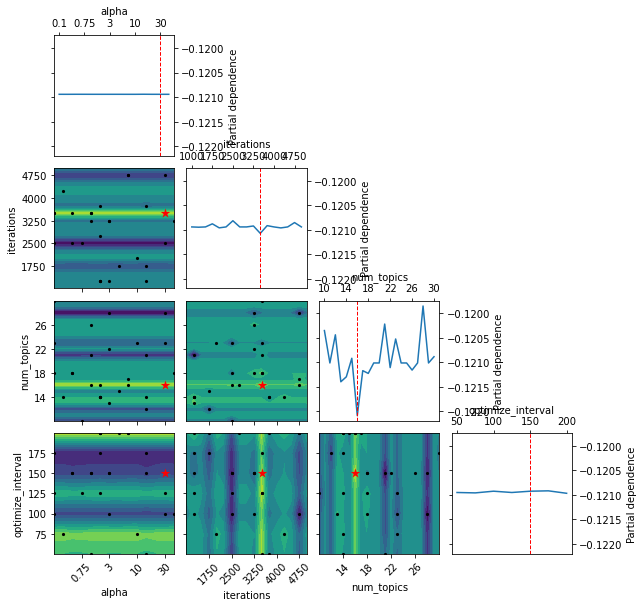

In [19]:
import matplotlib.pyplot as plt

_ = plot_objective(opt.optimizer_results_[0],
                   dimensions=["alpha","iterations", "num_topics","optimize_interval"],
                   n_minimum_search=int(1e8))
plt.show()

In [20]:
opt.total_iterations

270